# Script to aquire and pre-process OSM data to an Xarray cube

In [2]:
## Import libraries
# system
import os
import sys
import time
import calendar
import io
import requests
import multiprocessing as mp
from concurrent.futures import ThreadPoolExecutor, as_completed
import threading
from dotenv import load_dotenv
import logging


# aws bucket access
import boto3

# data manipulation
import json
import random
import overpass
from PIL import Image
from io import BytesIO
import numpy as np
import pandas as pd
import geopandas as gpd
import osmnx as ox
import rasterio as rio
import xarray as xr
import rioxarray as rxr
from rasterio.transform import from_bounds
from rasterio.features import geometry_mask, rasterize
from pyproj import Transformer, CRS
from shapely.geometry import box, shape, Polygon
#from samgeo import tms_to_geotiff

# visualization
from rasterio.plot import show
import leafmap
import folium
from ipyleaflet import Map, WMSLayer, basemaps, TileLayer, DrawControl, FullScreenControl, LayersControl, MeasureControl, SplitMapControl, WidgetControl
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.colors as mcolors
import matplotlib.cm as cm
import matplotlib as mpl
import seaborn as sns
from tqdm import tqdm

repo_name = 'masterthesis_genai_spatialplan'
if not repo_name in os.getcwd():
    os.chdir(repo_name)

p=os.popen('git rev-parse --show-toplevel')
repo_dir = p.read().strip()
p.close()

#seaborn cmap
rocket=sns.color_palette("rocket", as_cmap=True)
mako=sns.color_palette("mako", as_cmap=True)

### Get the boundaries of Leipzig

In [3]:
# Define bbox for entire Leipzig
xmin, ymin = 12.2714, 51.2705  # Southwest corner
xmax, ymax = 12.5019, 51.4174  # Northeast corner

# Create bbox polygon
bbox = box(xmin, ymin, xmax, ymax)

# Create GeoDataFrame
bbox_gdf = gpd.GeoDataFrame(geometry=[bbox], crs="EPSG:4326")

bbox_gdf.explore()

Create a grid for multithreading

In [7]:
# xmin, ymin, xmax, ymax = gdf.total_bounds
length = 0.03
width = 0.03

cols = list(np.arange(xmin, xmax + width, width))
rows = list(np.arange(ymin, ymax +length, length))

polygons = []
for x in cols[:-1]:
    for y in rows[:-1]:
        polygons.append(Polygon([
            (x, y), (x+width, y), (x+width, y+length), (x, y+length)
        ]))
grid = gpd.GeoDataFrame(geometry=polygons, crs="EPSG:4326")
# grid =gpd.overlay(grid, gdf, how='intersection')
grid.explore()

## Request OpenStreetMap Data

First try with the landuse

In [4]:
ox.settings.use_cache = True

bbox = (xmin, ymin, xmax, ymax)

# Define tags query
tags = {"landuse": True}  # True gets all landuse values

# Extract features
landuse_gdf = ox.features_from_bbox(
    (bbox[0],  # left
    bbox[1],  # bottom
    bbox[2],  # right
    bbox[3]),  # top
    tags=tags
)

# Clean and display
landuse_gdf = landuse_gdf[landuse_gdf.geometry.is_valid]
print(f"Number of features: {len(landuse_gdf)}")
print("\nLanduse types:")
print(landuse_gdf['landuse'].value_counts())

Number of features: 13191

Landuse types:
landuse
grass                      8106
residential                1227
allotments                  536
meadow                      505
forest                      437
farmland                    343
commercial                  329
construction                226
garages                     214
industrial                  214
brownfield                  197
railway                     187
retail                      165
village_green               100
flowerbed                    93
basin                        53
cemetery                     50
farmyard                     44
recreation_ground            34
greenfield                   33
orchard                      20
greenhouse_horticulture      17
religious                    14
landfill                     10
plant_nursery                 8
education                     3
reservoir                     3
quarry                        3
greenland                     2
military              

Explore the requested land use

In [ ]:
landuse_gdf[0:2000].explore()

In [ ]:
landuse_gdf.explore()

### Request data for a sample area

In [ ]:
#get everythign for a smaller area first

# Define bbox for urban area in Leipzig 
xmin_sample, ymin_sample = 12.3735, 51.324  # Southwest corner
xmax_sample, ymax_sample = 12.3935, 51.3321  # Northeast corner

# Create bbox polygon
bbox_sample = (xmin_sample, ymin_sample, xmax_sample, ymax_sample)

# get streets, water, parks and buildings, landuse
tags = {
    "building": True,
    "waterway": True,
    "natural": True, #["water", "wood", "grassland"],
    "highway": True,
    "landuse": True,
    "leisure": ["park", "garden"],
    "place": ["square"],
    "amenity": ["fountain", "school", "university", "college", "hospital", "kindergarten", "place_of_worship"],
    "aeroway": True,
    "railway": True,
}

# Extract features
leipzig_urban_gdf = ox.features_from_bbox(
    bbox=bbox_sample,
    tags=tags
)

# Clean and display
leipzig_urban_gdf = leipzig_urban_gdf[leipzig_urban_gdf.geometry.is_valid]
print(f"Number of features: {len(leipzig_urban_gdf)}")
print("\nFeature types:")
print(leipzig_urban_gdf['geometry'].type.value_counts())

Number of features: 3022

Feature types:
LineString      1459
Polygon          928
Point            632
MultiPolygon       3
Name: count, dtype: int64


In [19]:
leipzig_urban_gdf.explore()

### Rasterize the data

In [16]:
# filter out only buildings
buildings_gdf = leipzig_urban_gdf[leipzig_urban_gdf["building"].notnull()]
geom = [shapes for shapes in buildings_gdf.geometry]
transform = from_bounds(xmin, ymin, xmax, ymax, 1024, 1024)

There is two different approaches with rio, they are equally fast:

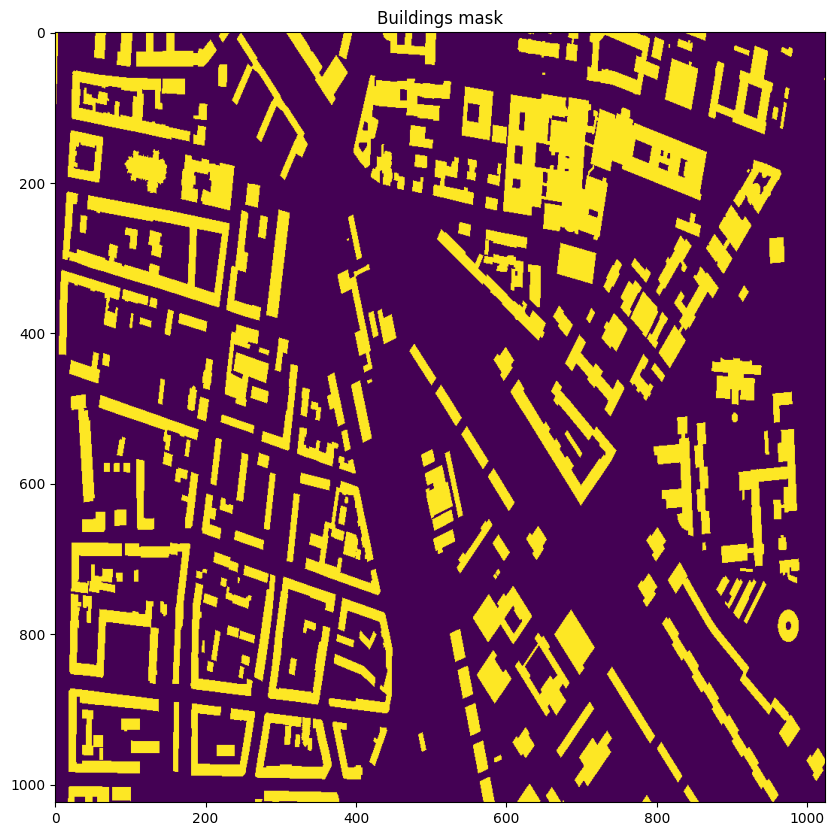

In [11]:
# Create raster
mask = geometry_mask(buildings_gdf.geometry, transform=transform, invert=True, out_shape=(1024, 1024))

# Plot
fig, ax = plt.subplots(figsize=(10, 10))
show(mask, ax=ax)
ax.set_title("Buildings mask")
plt.show()

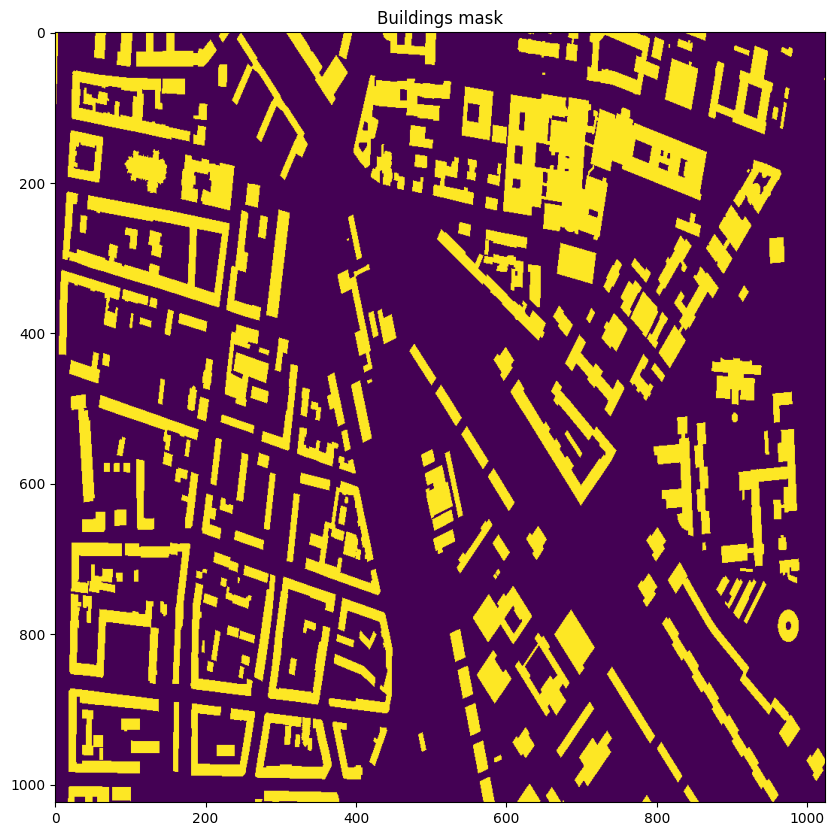

In [17]:
rasterized = rasterize(geom,
    out_shape = (1024, 1024),
    fill = 0,
    out = None,
    transform = transform,
    all_touched = False,
    default_value = 1,
    dtype = None)

# Plot
fig, ax = plt.subplots(figsize=(10, 10))
show(rasterized, ax=ax)
ax.set_title("Buildings mask")
plt.show()

Display it again on a leaflet map to check the conversion


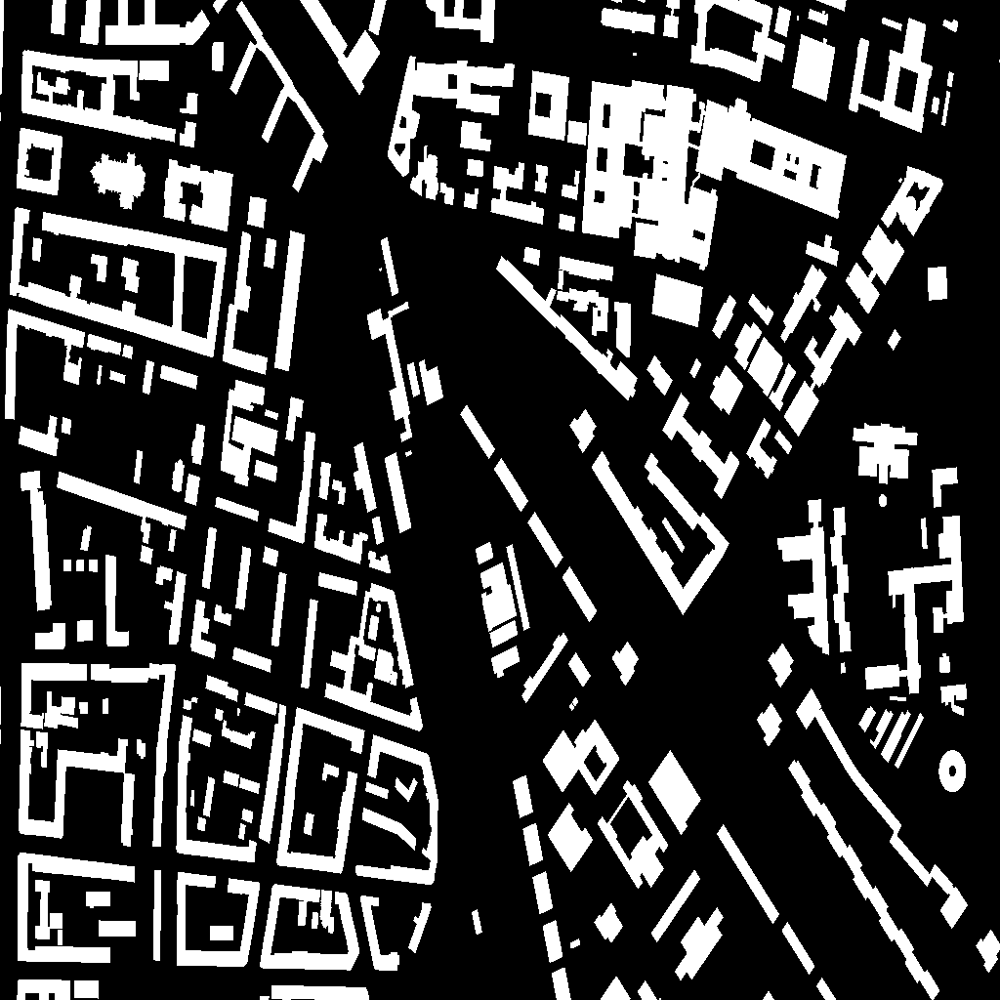

In [18]:
m = folium.Map([37, 0], zoom_start=1)

folium.raster_layers.ImageOverlay(
    image=rasterized,
    bounds=[[ymin, xmin], [ymax, xmax]],
    opacity=0.6,
).add_to(m)
m.add_child(folium.LayerControl())

m

## Download for the whole of Leipzig, seperate it by layers and convert features to xarray datasets

### Get it for the whole of Leipzig

OSMNX is nice for smaller requests to quickly retrieve data. For larger areas, it is better to use the Overpass API directly. The following code will download the data for the whole of Leipzig using multiple threads

In [8]:
# Define the tags you want to query
tags = {
    "building": True,
    "waterway": True,
    "natural": True,
    "highway": True,
    "landuse": True,
    "leisure": ["park", "garden"],
    "place": ["square"],
    "amenity": ["fountain", "school", "university", "college", "hospital", "kindergarten", "place_of_worship"],
    "aeroway": True,
    "railway": True,
}

# Function to suppress logs for Overpass API requests
def suppress_overpass_logs():
    logging.getLogger("urllib3").setLevel(logging.CRITICAL)
    logging.getLogger("requests").setLevel(logging.CRITICAL)

def restore_logs():
    # Restore the default logging level
    logging.getLogger("urllib3").setLevel(logging.NOTSET)
    logging.getLogger("requests").setLevel(logging.NOTSET)

# Create Overpass query for tags
def create_query(bbox, tags):
    query_parts = []
    
    osm_graph_type = "wr"  # nwr, node, way, etc.
    
    for tag, value in tags.items():
        
        # If the value is True, it means we just need to check for the existence of the tag
        if value is True:
            query_parts.append(f'{osm_graph_type}["{tag}"]({bbox[1]},{bbox[0]},{bbox[3]},{bbox[2]});')
        
        elif isinstance(value, list) and len(value) > 1:
            # If the value is a list, use a regex match for multiple possible values
            query_parts.append(f'{osm_graph_type}["{tag}"~"{ "|".join(value)}"]({bbox[1]},{bbox[0]},{bbox[3]},{bbox[2]});')
        # If the value is a single string, use an exact match
        else:
            query_parts.append(f'{osm_graph_type}["{tag}"="{value}"]({bbox[1]},{bbox[0]},{bbox[3]},{bbox[2]});')
            
    #join to a single query without out or other meta statements
    query = "("+"\n".join(query_parts) +");"
    return query


# Initialize the Overpass API
api = overpass.API(debug=False, timeout=900)

def fetch_overpass_data(bbox, tags, retries=5, delay=2):
    
    query = create_query(bbox, tags)
    
    for attempt in range(retries):
        try:
            suppress_overpass_logs()
            response = api.Get(query, responseformat="geojson", verbosity='geom')
            restore_logs()
            
            gdf = gpd.GeoDataFrame.from_features(response['features']) 
            
            #drop nodes column
            if 'nodes' in gdf.columns:
                gdf = gdf.drop(columns=['nodes'])
                
            #create columns for columns.tags
            for col in gdf.columns:
                if col == 'tags':
                    for key, value in gdf[col].items():
                        if isinstance(value, dict):
                            for k, v in value.items():
                                gdf.loc[key, k] = v
                        else:
                            gdf.loc[key, col] = value
                        
                    gdf = gdf.drop(columns=[col])
                
            # drop all columns where not at least 1/len(tags)/2 % data - so columns where for a tag the column has at least 50% of data
            gdf = gdf.dropna(axis=1, thresh=len(gdf) * 1/len(tags)*0.5)
                
            return gdf
        except Exception as e:
            # print(f"Error fetching data: {e}")
            time.sleep(delay)
            
    print(f"Failed to fetch data after {retries} attempts.")
    return None
    
# Multithreaded feature extraction for a grid
def extract_features_grid(grid, tags):
    features = []
    with ThreadPoolExecutor(max_workers=int(mp.cpu_count()/2)) as executor:
        futures = {executor.submit(fetch_overpass_data, row.geometry.bounds, tags): row for _, row in grid.iterrows()}
        for future in tqdm(as_completed(futures), total=len(futures)):
            try:
                features.append(future.result())
            except Exception as e:
                print(f"Error: {e}")
    return pd.concat(features, ignore_index=True)

# Execute the function
leipzig_urban_gdf = extract_features_grid(grid, tags)

100%|██████████| 40/40 [10:13<00:00, 15.34s/it]


In [19]:
# Clean geometry
leipzig_urban_gdf = leipzig_urban_gdf[leipzig_urban_gdf.geometry.is_valid]

#remove duplicates by id
leipzig_urban_gdf = leipzig_urban_gdf.drop_duplicates(subset=['id'])

#set crs to EPSG:4326
leipzig_urban_gdf.crs = "EPSG:4326"

#display summary of features
print(f"Number of features: {len(leipzig_urban_gdf)}")
print("\nFeature types:")
print(leipzig_urban_gdf['geometry'].type.value_counts())

Number of features: 222311

Feature types:
Polygon            135576
LineString          84339
MultiPolygon         2388
MultiLineString         8
Name: count, dtype: int64


Write to parquet for easier access

In [20]:
#write to parquet
leipzig_urban_gdf.to_parquet(f"{repo_dir}/data/osm/leipzig_urban_gdf.parquet", index=False)

In [21]:
#read from parquet
leipzig_urban_gdf = gpd.read_parquet(f"{repo_dir}/data/osm/leipzig_urban_gdf.parquet")

#filter out invalid geometries
leipzig_urban_gdf = leipzig_urban_gdf[leipzig_urban_gdf.geometry.is_valid]

leipzig_urban_gdf.head(5)

,geometry,type,id,highway,name,surface,access,landuse,addr:city,addr:housenumber,...,electrified,frequency,gauge,voltage,heritage,wikidata,horse,addr:suburb,parking:lane:both,building:use
0,"LINESTRING (12.28738 51.30289, 12.28738 51.302...",way,23238325,tertiary,Raiffeisenstraße,asphalt,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
1,"LINESTRING (12.28957 51.29698, 12.28876 51.298...",way,23238361,tertiary,Raiffeisenstraße,asphalt,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
2,"LINESTRING (12.28817 51.29892, 12.28839 51.298...",way,23238362,tertiary,Raiffeisenstraße,asphalt,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
3,"LINESTRING (12.29061 51.29456, 12.29079 51.294...",way,23238363,tertiary,Raiffeisenstraße,asphalt,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None
4,"LINESTRING (12.29424 51.29095, 12.2944 51.2906...",way,24219148,tertiary,Albersdorfer Straße,asphalt,None,None,None,None,...,None,None,None,None,None,None,None,None,None,None


### Get street with more appropriate width and convert to xarray ds

Note: smootheness is the "physical usability of a way for wheeled vehicles, particularly regarding surface regularity/flatness" https://wiki.openstreetmap.org/wiki/Key:smoothness

In [22]:
#filter out streets
streets_gdf = leipzig_urban_gdf[leipzig_urban_gdf["highway"].notnull()]
streets_gdf = streets_gdf[streets_gdf.geometry.type == "LineString"]

#remove all columns where more than 50% nans
streets_gdf = streets_gdf.dropna(axis=1, thresh=len(streets_gdf) * 0.5)

#rename lit to lighting
streets_gdf = streets_gdf.rename(columns={"lit": "lighting"})

streets_gdf

,geometry,type,id,highway,surface
0,"LINESTRING (12.28738 51.30289, 12.28738 51.302...",way,23238325,tertiary,asphalt
1,"LINESTRING (12.28957 51.29698, 12.28876 51.298...",way,23238361,tertiary,asphalt
2,"LINESTRING (12.28817 51.29892, 12.28839 51.298...",way,23238362,tertiary,asphalt
3,"LINESTRING (12.29061 51.29456, 12.29079 51.294...",way,23238363,tertiary,asphalt
4,"LINESTRING (12.29424 51.29095, 12.2944 51.2906...",way,24219148,tertiary,asphalt
...,...,...,...,...,...
222288,"LINESTRING (12.4859 51.37901, 12.48596 51.37894)",way,1339048303,service,sett
222293,"LINESTRING (12.48691 51.38182, 12.48743 51.382...",way,1340373736,service,None
222301,"LINESTRING (12.4849 51.37872, 12.48492 51.37873)",way,1353192358,service,asphalt
222302,"LINESTRING (12.48314 51.3795, 12.48318 51.37951)",way,1353192359,residential,None


Convert to polygons with width by feature based buffering

The width for german streets is managed by:
-  Richtlinien für die Anlage von Autobahnen https://www.fgsv-verlag.de/raa-guidelines-for-the-design-of-motorways-edition-2008-translation-2011-englische-ubersetzung
- Richtlinien für die Anlage von Landstraßen https://www.bast.de/DE/Verkehrstechnik/Fachthemen/v1-strassentypen.html

We simplify the values for the different highway classes:


In [24]:
# create a dict for highway classifications and their corresponding widths
widths = {
    'motorway': 24,
    'motorway_link': 16,
    'trunk': 24,
    'trunk_link': 16,
    'primary': 15,
    'primary_link': 12,
    'secondary': 12,
    'secondary_link': 11,
    'tertiary': 11,
    'tertiary_link': 11,
    'residential': 5.5,
    'living_street': 5.5,
    'pedestrian': 2,
    'road': 11,	
    'service': 5.5,
    'minor_service': 5.5,
    'footway': 2,
    'cycleway': 2,
    'path': 2,
    'steps': 2,
}

# Apply the width classification
streets_gdf['buffer_width'] = streets_gdf['highway'].apply(lambda x: widths.get(x, 5.5))  # Default to 5.5 if not found

#convert to projected coordinates (UTM 33N)
streets_gdf = streets_gdf.to_crs(epsg=32633)

# Create the buffer polygons with the appropriate width
streets_gdf["geometry"] = streets_gdf.apply(lambda row: row['geometry'].buffer(row['buffer_width']), axis=1)

# convert back to WGS84
streets_gdf = streets_gdf.to_crs(epsg=4326)

In [26]:
streets_gdf[1:100].explore()